#AI for Education

#1. Import Library and Dataset

In [ ]:
!pip install tensorflow # Installs TensorFlow library
!pip install keras # Installs keras library

In [ ]:
from google.colab import drive
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers , models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications import efficientnet_v2 , NASNetLarge
import tensorflow_hub as hub
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
import os
from datetime import datetime

%matplotlib inline

In [ ]:
drive.mount('/content/gdrive',force_remount=True)

Mounted at /content/gdrive


#2.  data preparation (การเตรียม ชุดข้อมูล)

In [ ]:
#train_path = "/content/gdrive/MyDrive/CS265 Project/train" # @param{type:"string"}
#test_path = "/content/gdrive/MyDrive/CS265 Project/test" # @param{type:"string"}
#valid_path = "/content/gdrive/MyDrive/CS265 Project/valid" # @param{type:"string"}

train_path = "/content/gdrive/MyDrive/Year2Term2/CS265/Project/train" # @param{type:"string"}
test_path = "/content/gdrive/MyDrive/Year2Term2/CS265/Project/test" # @param{type:"string"}
valid_path = "/content/gdrive/MyDrive/Year2Term2/CS265/Project/valid" # @param{type:"string"}

In [ ]:
# @title 2.1. Set up Custom parameter Datagen { display-mode: "form" }
ROTATION_RANGE = 0 # @param {type:"number"}
HORIZONTAL_FLIP = False # @param{type:"boolean"}
VERTICAL_FLIP = False # @param{type:"boolean"}
ZOOM_RANGE = 0 # @param {type:"number"}
WIDTH_SHIFT_RANGE = 0 # @param {type:"number"}
HEIGHT_SHIFT_RANGE = 0 # @param {type:"number"}

BATCH_SIZE = 32 # @param{type:"integer"}
IMAGE_SIZE = 224 # @param{type:"integer"}

In [ ]:
# @title 2.2 Run ImageDataGenerator

train_datagen = ImageDataGenerator( width_shift_range = WIDTH_SHIFT_RANGE ,
                                   height_shift_range = HEIGHT_SHIFT_RANGE,
                                   rotation_range =  ROTATION_RANGE ,
                                   horizontal_flip =  HORIZONTAL_FLIP ,
                                   vertical_flip = VERTICAL_FLIP ,
                                   zoom_range = ZOOM_RANGE)
train_generator = train_datagen.flow_from_directory(
        directory=train_path,
        target_size=(IMAGE_SIZE, IMAGE_SIZE),
        batch_size=BATCH_SIZE,
        class_mode='categorical')


test_datagen = ImageDataGenerator( width_shift_range = WIDTH_SHIFT_RANGE ,
                                   height_shift_range = HEIGHT_SHIFT_RANGE,
                                   rotation_range =  ROTATION_RANGE ,
                                   horizontal_flip =  HORIZONTAL_FLIP ,
                                   vertical_flip = VERTICAL_FLIP ,
                                   zoom_range = ZOOM_RANGE)
test_generator = test_datagen.flow_from_directory(
        directory=test_path,
        target_size=(IMAGE_SIZE, IMAGE_SIZE),
        batch_size=BATCH_SIZE,
        shuffle = False,
        class_mode='categorical')


valid_datagen = ImageDataGenerator( width_shift_range = WIDTH_SHIFT_RANGE ,
                                   height_shift_range = HEIGHT_SHIFT_RANGE,
                                   rotation_range =  ROTATION_RANGE ,
                                   horizontal_flip =  HORIZONTAL_FLIP ,
                                   vertical_flip = VERTICAL_FLIP ,
                                   zoom_range = ZOOM_RANGE)
valid_generator = valid_datagen.flow_from_directory(
        directory=valid_path,
        target_size=(IMAGE_SIZE, IMAGE_SIZE),
        batch_size=BATCH_SIZE,
        shuffle = False,
        class_mode='categorical')



Found 700 images belonging to 7 classes.
Found 150 images belonging to 7 classes.
Found 150 images belonging to 7 classes.


In [ ]:
class_names = train_generator.class_indices
class_names

{'Disappear': 0,
 'Eating': 1,
 'Gape': 2,
 'Ignore': 3,
 'Normal': 4,
 'Play mobile phone': 5,
 'Sleep': 6}

In [ ]:
CLASS_SIZE = len(class_names)

#3. Create Model

In [ ]:
import random
SEED = 42
os.environ['PYTHONHASHSEED']=str(SEED)
os.environ['TF_CUDNN_DETERMINISTIC'] = '1'  # TF 2.1
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

#set seed

In [ ]:
# @title เลือก Model ที่นำมาใช้ Train
model_name = "RestNet-50" # @param ["MobileNetV3Small", "RestNet-50",  "EfficientNetV2L", "NASNetLarge"]

In [ ]:
if model_name =="MobileNetV3Small" :
  base_model = keras.applications.MobileNetV3Small(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3),include_top=False, weights='imagenet') # Load the MobileNetV3Small model
  base_model.trainable = True # Enable to train Pre-Trained Model
if model_name == "RestNet-50":
  base_model = ResNet50(
    input_shape = [IMAGE_SIZE , IMAGE_SIZE ] + [3], # Making the image into 3 Channel, so concating 3.
    weights = 'imagenet', # Default weights.
    include_top = False   #
  )
  base_model.trainable = True # Enable to train Pre-Trained Model
if model_name == "EfficientNetV2L":
  base_model = efficientnet_v2.EfficientNetV2B0(include_top=False,
                                                input_shape= [IMAGE_SIZE , IMAGE_SIZE ] + [3],
                                                weights="imagenet")

if model_name == "NASNetLarge":
  base_model = NASNetLarge(

    include_top=False,
    input_shape = [IMAGE_SIZE , IMAGE_SIZE ] + [3],
    weights="imagenet",
  )


inputs = tf.keras.layers.Input(shape=(224, 224, 3), name="input_layer") # Define input layer


94765736/94765736 [==============================] - 5s 0us/step


In [ ]:

x = inputs # Apply Augmentation to the input images. this use for decrease overfit
x = base_model(x, training=False) # Pass Augmentation Data to base_model
x = layers.GlobalAveragePooling2D(name="GloPool")(x) # Create Global Average Pooling and input x to get output tensor that value = Dense's filter. this use for decrease feature map
outputs = tf.keras.layers.Dense(CLASS_SIZE, activation="softmax", name="output_layer")(x) # output layer that (output unit = CLASS_SIZE as image class, activation function is softmax  )
model_0 = tf.keras.Model(inputs, outputs) # Create Model name model_0 that have input layer, base mosel, output layer
model_0.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(0.0001),
              metrics=["accuracy"]) #Compile model_0 with categorical_crossentropy, adam's learning rate = 0.0001, metric by accuracy


In [ ]:
model_0.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 GloPool (GlobalAveragePool  (None, 2048)              0         
 ing2D)                                                          
                                                                 
 output_layer (Dense)        (None, 7)                 14343     
                                                                 
Total params: 23602055 (90.03 MB)
Trainable params: 23548935 (89.83 MB)
Non-trainable params: 53120 (207.50 KB)
_________________________________________________________________


In [ ]:
custom_early_stopping = EarlyStopping( # EarlyStopping is keras's callback function that stop training model before overfitting
    monitor='val_loss', # monitor at validation loss
    patience=10,
    min_delta=0.000000001, # if validation loss is not decrease at least 0.001 in 10 time
    mode='min' # need validtion loss to decrease
)

#3.Train Model

In [ ]:
start = datetime.now()

history = model_0.fit(train_generator, # Use from train generator
           epochs=30, # training round
           workers=0,
           steps_per_epoch=len(train_generator), # Use from batch size that can update each epoch for training
           validation_data=valid_generator, # Use from test generator
           validation_steps=len(valid_generator),
           callbacks=[custom_early_stopping]) # Stop training when overfitting

print ('Execution Time: ',datetime.now()-start)


Epoch 1/30
22/22 [==============================] - 555s 24s/step - loss: 1.6015 - accuracy: 0.4171 - val_loss: 0.8508 - val_accuracy: 0.6933
Epoch 2/30
22/22 [==============================] - 25s 1s/step - loss: 0.6967 - accuracy: 0.7629 - val_loss: 0.5285 - val_accuracy: 0.8000
Epoch 3/30
22/22 [==============================] - 25s 1s/step - loss: 0.4113 - accuracy: 0.8629 - val_loss: 0.2536 - val_accuracy: 0.9333
Epoch 4/30
22/22 [==============================] - 25s 1s/step - loss: 0.2549 - accuracy: 0.9243 - val_loss: 0.1361 - val_accuracy: 0.9600
Epoch 5/30
22/22 [==============================] - 25s 1s/step - loss: 0.1567 - accuracy: 0.9471 - val_loss: 0.2271 - val_accuracy: 0.9200
Epoch 6/30
22/22 [==============================] - 25s 1s/step - loss: 0.1835 - accuracy: 0.9429 - val_loss: 0.1548 - val_accuracy: 0.9467
Epoch 7/30
22/22 [==============================] - 25s 1s/step - loss: 0.0757 - accuracy: 0.9729 - val_loss: 0.1456 - val_accuracy: 0.9800
Epoch 8/30
22/22 [

In [ ]:
#@title 3.2. Evaluate the model on the test set
test_loss, test_acc = model_0.evaluate_generator(test_generator, steps=len(test_generator))
print('Test loss:', test_loss)
print('Test accuracy:', test_acc)

<ipython-input-21-74d96c32e9dc>:2: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  test_loss, test_acc = model_0.evaluate_generator(test_generator, steps=len(test_generator))


Test loss: 0.4575510621070862
Test accuracy: 0.9133333563804626


#4.Evaluate Model (สรุปผล Model)

In [ ]:
# Evaluate the model on the test set
start = datetime.now()
test_loss, test_acc = model_0.evaluate_generator(test_generator, steps=len(test_generator))
print('Test loss:', test_loss)
print('Test accuracy:', test_acc)
print('Test Time:',datetime.now()-start)


<ipython-input-22-0897c54d69da>:3: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  test_loss, test_acc = model_0.evaluate_generator(test_generator, steps=len(test_generator))


Test loss: 0.4575510621070862
Test accuracy: 0.9133333563804626
Test Time: 0:00:05.827988


5/5 [==============================] - 3s 420ms/step


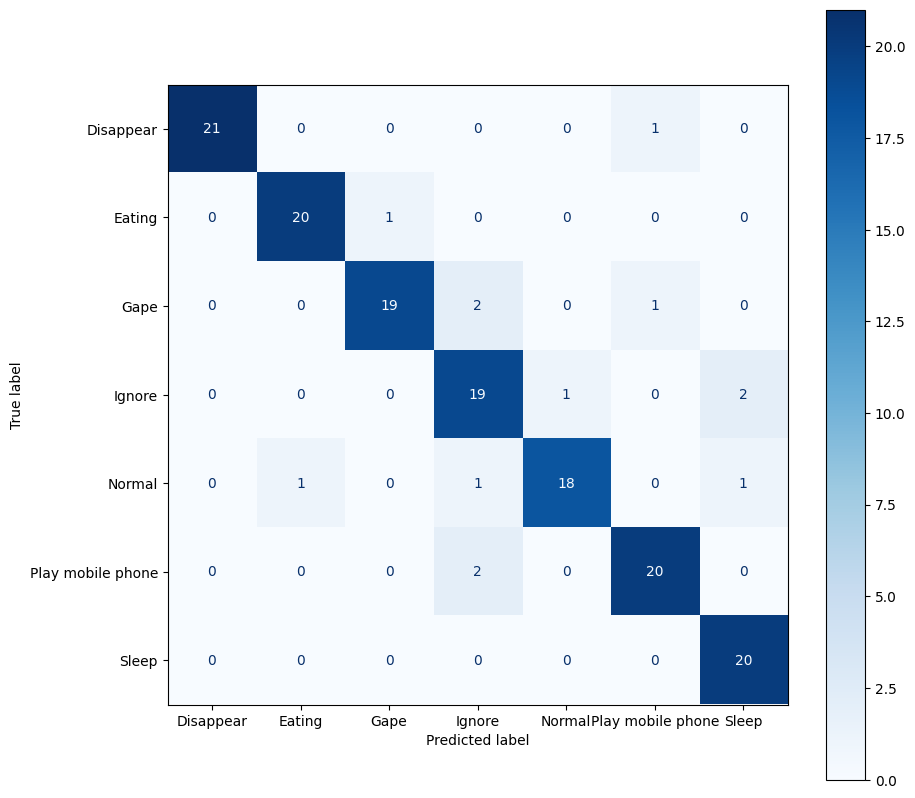

,class,specificity,sensitivity
0,0,1.000000,0.954545
1,1,0.992248,0.952381
2,2,0.992188,0.863636
3,3,0.960938,0.863636
4,4,0.992248,0.857143
5,5,0.984375,0.909091
6,6,0.976923,1.000000


In [ ]:
import sklearn as scikit_learn
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix
import numpy as np
from sklearn.metrics import precision_recall_fscore_support

test_true=test_generator.classes[test_generator.index_array]
test_pred_raw = model_0.predict(test_generator)
test_pred = np.argmax(test_pred_raw, axis=1)

cm = confusion_matrix(test_true, test_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax,cmap=plt.cm.Blues)
plt.show()


res = []
for l in range(CLASS_SIZE):
    pres,recall,_,_ = precision_recall_fscore_support(np.array(test_true)==l,np.array(test_pred)==l,pos_label=True,average=None)
    res.append([l,recall[0],recall[1]])

pd.DataFrame(res,columns = ['class','specificity','sensitivity'])


In [ ]:
from sklearn.metrics import classification_report


report = classification_report(test_true, test_pred, target_names=class_names)
print(report)


                   precision    recall  f1-score   support

        Disappear       1.00      0.95      0.98        22
           Eating       0.95      0.95      0.95        21
             Gape       0.95      0.86      0.90        22
           Ignore       0.79      0.86      0.83        22
           Normal       0.95      0.86      0.90        21
Play mobile phone       0.91      0.91      0.91        22
            Sleep       0.87      1.00      0.93        20

         accuracy                           0.91       150
        macro avg       0.92      0.91      0.91       150
     weighted avg       0.92      0.91      0.91       150



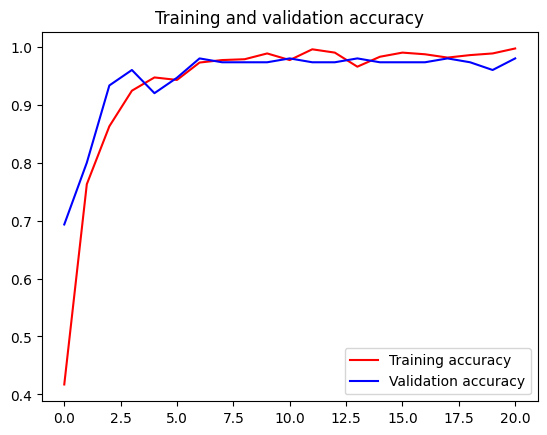

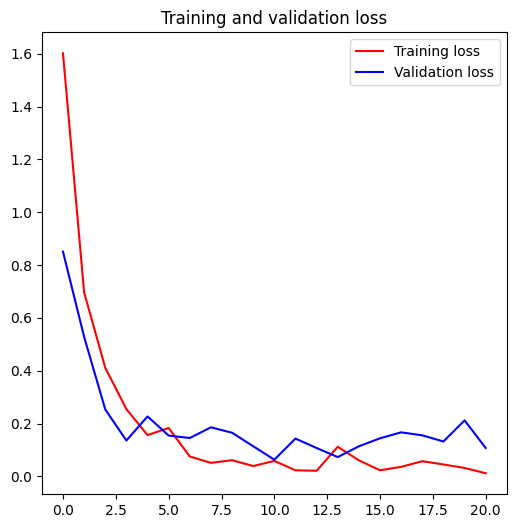

<Figure size 600x600 with 0 Axes>

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.figure(figsize=(6,6))

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend(loc=0)
plt.figure(figsize=(6,6))

plt.show()


#5. Save & Load h5 Model

In [ ]:
# Save the trained model to a .h5 file
model_0.save('/content/gdrive/MyDrive/CS265 Project/dataset/model/trainedmodel.h5')


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from keras.models import load_model
model = load_model('/content/gdrive/MyDrive/CS265 Project/dataset/model/trainedmodel.h5')
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.OPTIMIZE_FOR_LATENCY]
tflite_model = converter.convert()
open("/content/gdrive/MyDrive/CS265 Project/dataset/model/tflitemodel.tflite", "wb").write(tflite_model)


23944792

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Saving 735402734.657004.mp4 to 735402734.657004.mp4
User uploaded file "735402734.657004.mp4" with length 27696254 bytes


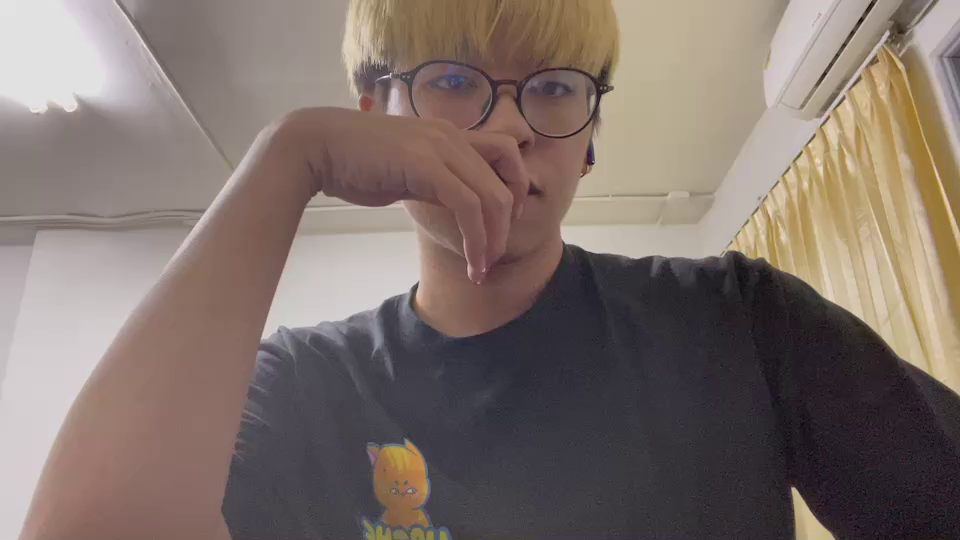

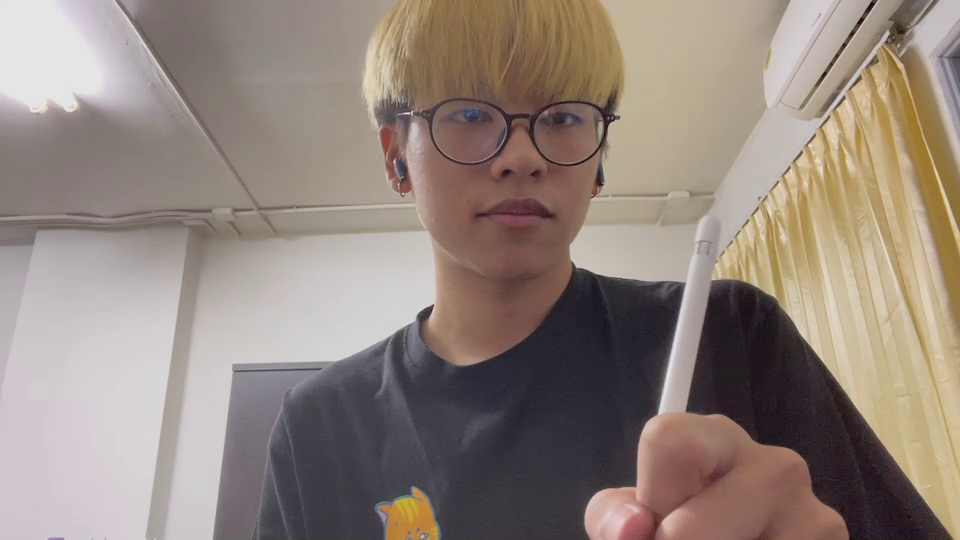

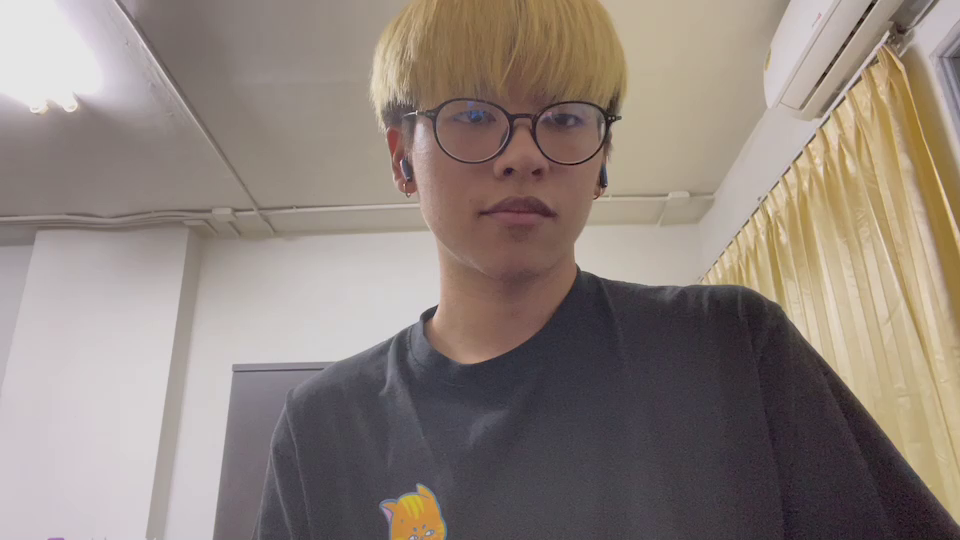

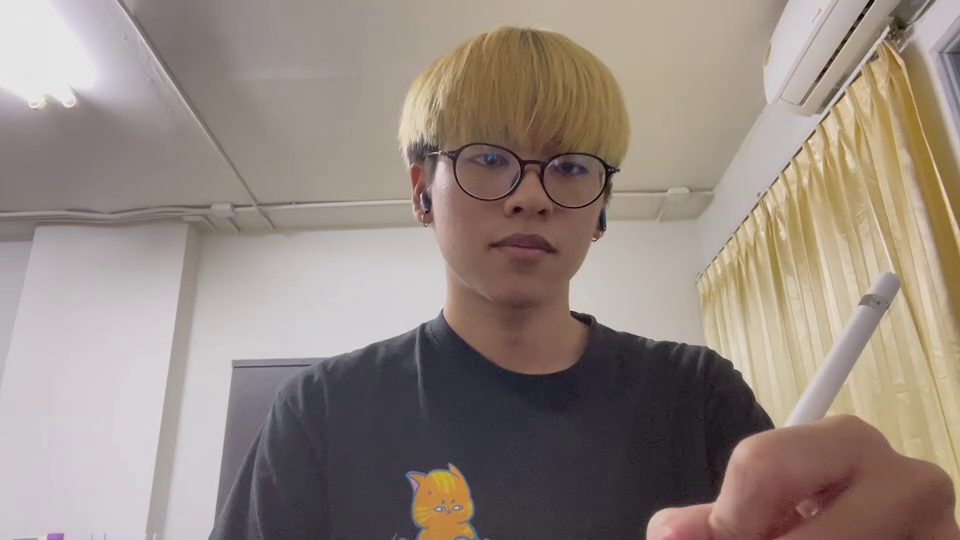

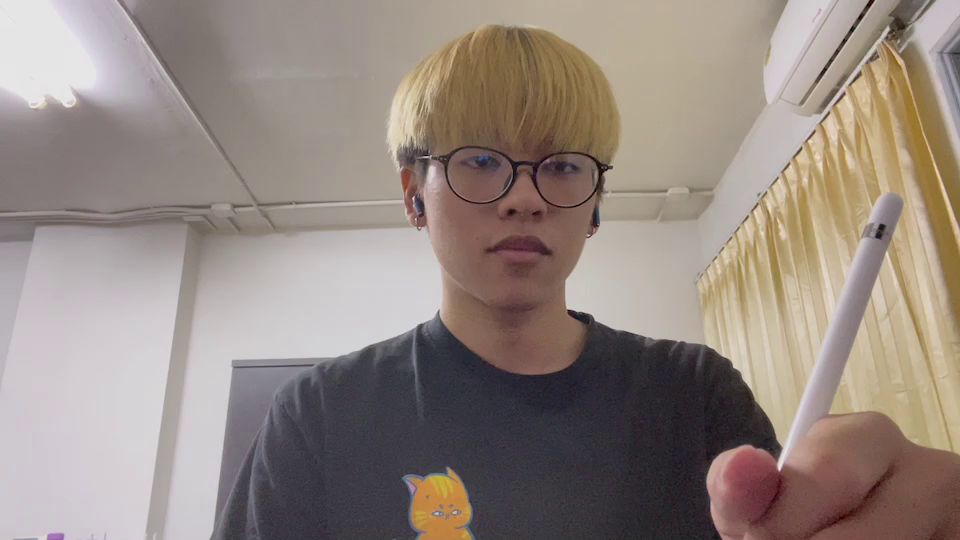

...

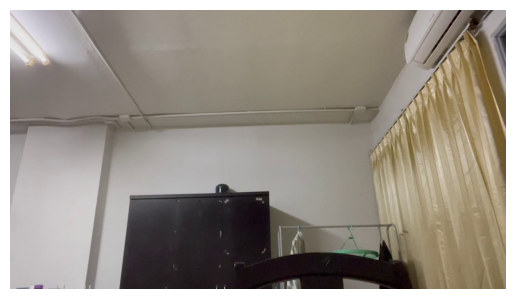

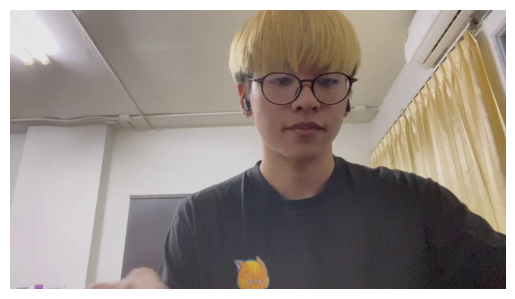

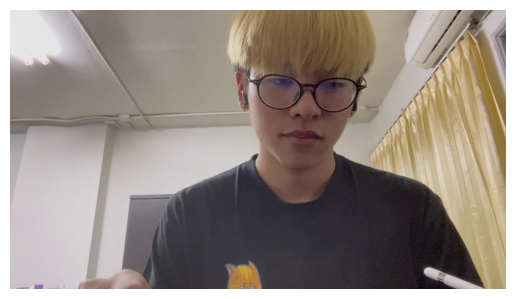

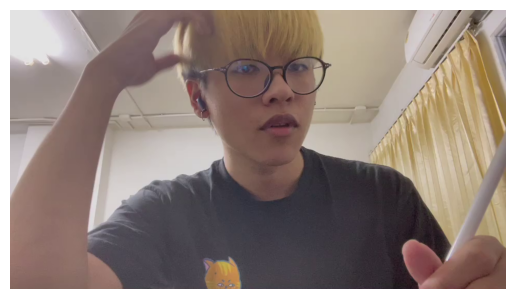

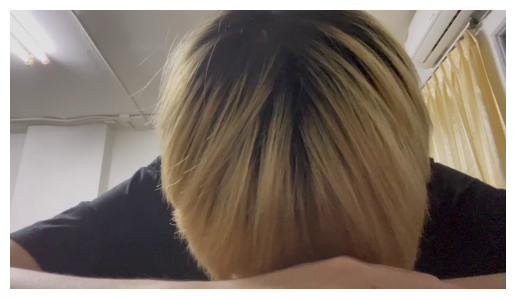

In [ ]:
from google.colab.patches import cv2_imshow
from google.colab import files
import cv2
import matplotlib.pyplot as plt  # ย้าย import ไว้ด้านบน

# Upload video file
uploaded = files.upload()

genpic = []  # เพิ่มตัวแปร genpic เพื่อเก็บรูปภาพที่ถูกรันออกมา

for fn in uploaded.keys():
    print('User uploaded file "{name}" with length {length} bytes'.format(
        name=fn, length=len(uploaded[fn])))

    # Read the uploaded video file using OpenCV
    cap = cv2.VideoCapture(fn)

    if not cap.isOpened():
        print("Error: Could not open video file")
    else:
        fps = cap.get(cv2.CAP_PROP_FPS)  # Read frames per second (FPS) of the video
        frame_interval = int(fps) * 5  # Show every 10 seconds worth of frames

        while True:
            ret, frame = cap.read()
            if not ret:
                break  # Break if video ends or error occurs

            # เพิ่มภาพลงใน genpic
            genpic.append(frame)

            cv2_imshow(frame)  # Display frame

            # Wait for 1 millisecond
            # and check if the user presses 'q' to quit displaying frames
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break

            # Skip frames based on frame_interval
            for _ in range(frame_interval - 1):
                ret, _ = cap.read()
                if not ret:
                    break

        # Release resources
        cap.release()
        cv2.destroyAllWindows()

# Loop through each image in genpic for analysis
for img in genpic:
    img_array = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    plt.imshow(img_array)  # Display image
    plt.axis('off')  # Turn off axis
    plt.show()  # Show image


In [ ]:
numgenpic =  len(genpic)
print("Number of images in genpic:", numgenpic)


Number of images in genpic: 25


In [ ]:
# import matplotlib.pyplot as plt
# from tensorflow.keras.preprocessing import image
# import cv2
# import numpy as np

# # Loop through each image in genpic for analysis
# for img in genpic:
#     img_array = cv2.resize(img, (224, 224))  # Resize image to target size
#     img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
#     img_array = tf.keras.applications.mobilenet_v3.preprocess_input(img_array)  # Preprocess image

#     # Make prediction
#     prediction = model.predict(img_array)
#     class_names = train_generator.class_indices
#     class_names = {v: k for k, v in class_names.items()}  # Reverse the class_indices dictionary
#     predicted_class = np.argmax(prediction, axis=1)
#     predicted_class_name = class_names[predicted_class[0]]
#     predicted_prob = np.max(prediction, axis=1)

#     # Print the result
#     print("Predicted class: {} ({:.2f}%)".format(predicted_class_name, predicted_prob[0]*100))
#     prediction_list = prediction.tolist()  # Convert the NumPy array to a Python list
#     prediction_formatted = ["{:.2%}".format(p) for p in prediction_list[0]]
#     print("Prediction: ", prediction_formatted)

#     # Display the image with prediction
#     plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
#     plt.title("Predicted class: {} ({:.2f}%)".format(predicted_class_name, predicted_prob[0]*100))
#     plt.show()
#     print("\n")


1/1 [==============================] - 1s 1s/step
Predicted class: Sleep (34.86%)
Prediction:  ['10.39%', '10.83%', '11.00%', '25.86%', '5.06%', '2.01%', '34.86%']


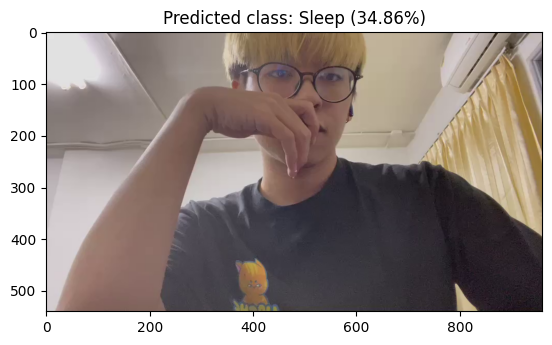



1/1 [==============================] - 0s 23ms/step
Predicted class: Normal (99.28%)
Prediction:  ['0.00%', '0.06%', '0.00%', '0.58%', '99.28%', '0.07%', '0.00%']


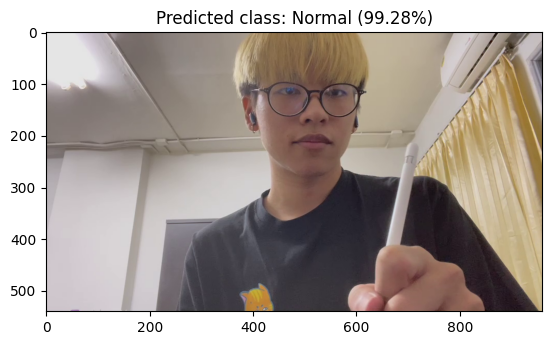



1/1 [==============================] - 0s 33ms/step
Predicted class: Ignore (47.18%)
Prediction:  ['0.03%', '5.54%', '0.00%', '47.18%', '47.14%', '0.11%', '0.00%']


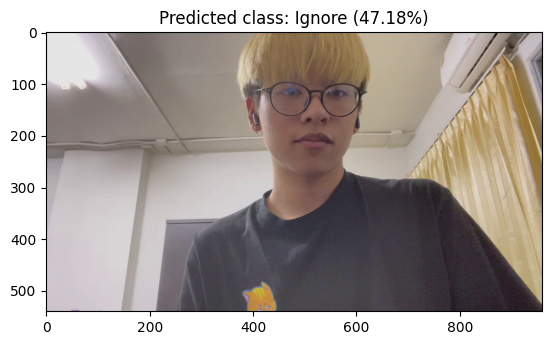



1/1 [==============================] - 0s 25ms/step
Predicted class: Normal (98.52%)
Prediction:  ['0.00%', '0.06%', '0.00%', '0.31%', '98.52%', '1.11%', '0.00%']


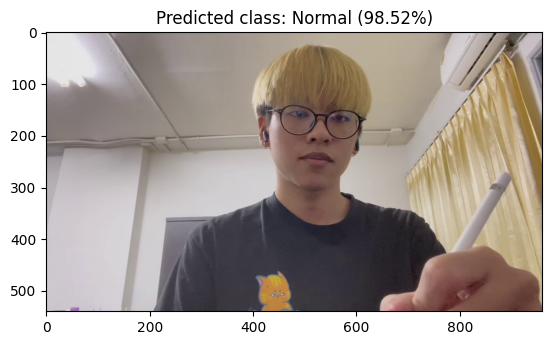



1/1 [==============================] - 0s 24ms/step
Predicted class: Normal (98.84%)
Prediction:  ['0.00%', '0.08%', '0.00%', '0.37%', '98.84%', '0.71%', '0.00%']


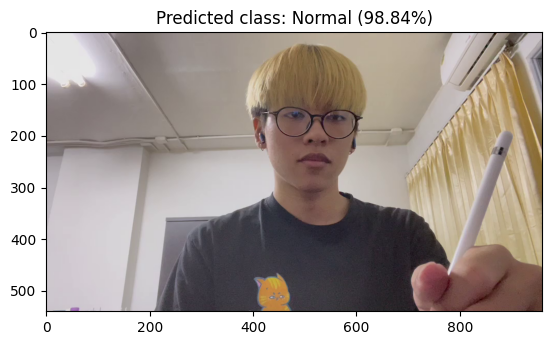



1/1 [==============================] - 0s 23ms/step
Predicted class: Normal (82.47%)
Prediction:  ['0.00%', '0.07%', '0.00%', '0.00%', '82.47%', '17.46%', '0.00%']


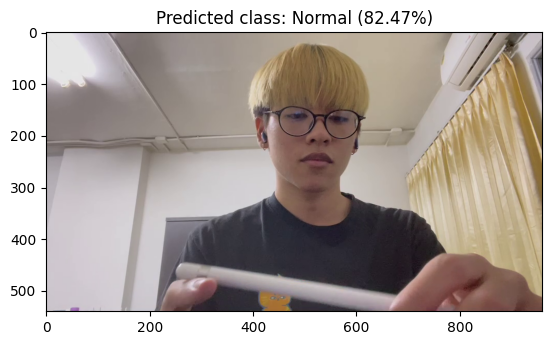



1/1 [==============================] - 0s 27ms/step
Predicted class: Gape (99.99%)
Prediction:  ['0.00%', '0.01%', '99.99%', '0.00%', '0.00%', '0.00%', '0.00%']


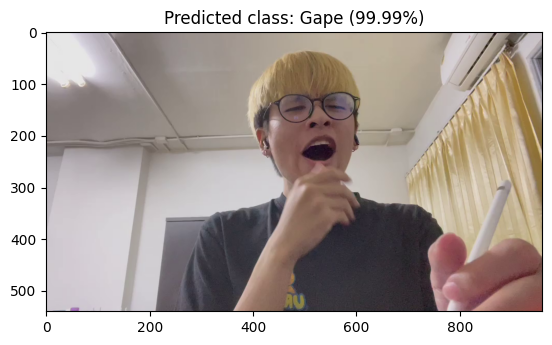



1/1 [==============================] - 0s 23ms/step
Predicted class: Ignore (99.98%)
Prediction:  ['0.00%', '0.00%', '0.00%', '99.98%', '0.00%', '0.01%', '0.00%']


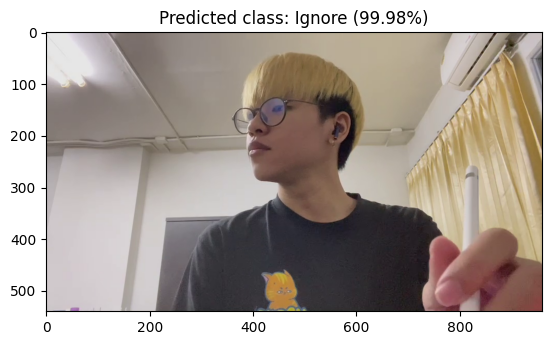



1/1 [==============================] - 0s 24ms/step
Predicted class: Ignore (89.73%)
Prediction:  ['0.04%', '0.03%', '0.80%', '89.73%', '0.18%', '0.32%', '8.89%']


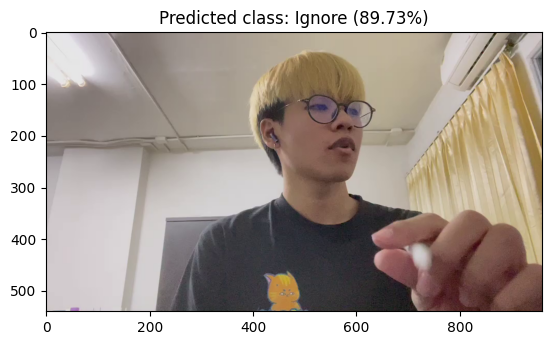



1/1 [==============================] - 0s 24ms/step
Predicted class: Normal (99.60%)
Prediction:  ['0.00%', '0.02%', '0.00%', '0.04%', '99.60%', '0.34%', '0.00%']


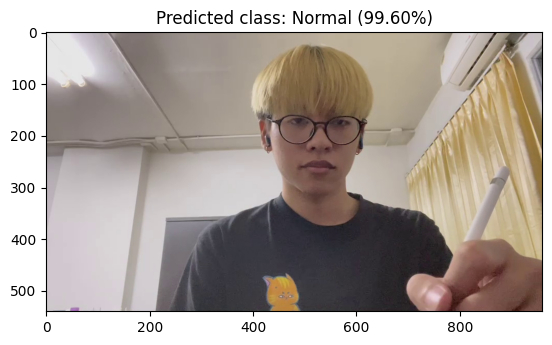



1/1 [==============================] - 0s 24ms/step
Predicted class: Normal (99.21%)
Prediction:  ['0.00%', '0.04%', '0.00%', '0.22%', '99.21%', '0.53%', '0.00%']


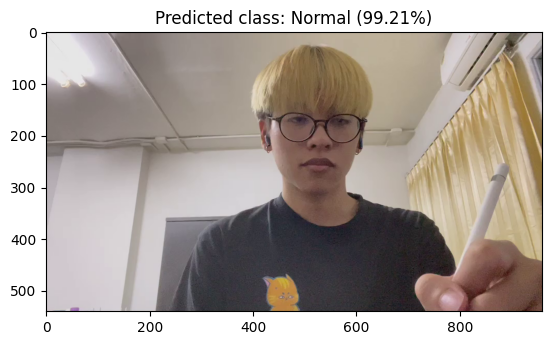



1/1 [==============================] - 0s 24ms/step
Predicted class: Ignore (99.88%)
Prediction:  ['0.00%', '0.01%', '0.01%', '99.88%', '0.03%', '0.05%', '0.01%']


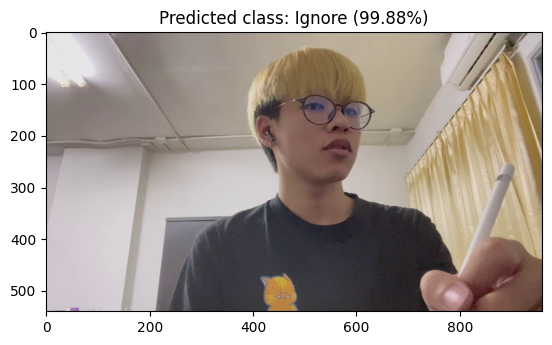



1/1 [==============================] - 0s 46ms/step
Predicted class: Ignore (100.00%)
Prediction:  ['0.00%', '0.00%', '0.00%', '100.00%', '0.00%', '0.00%', '0.00%']


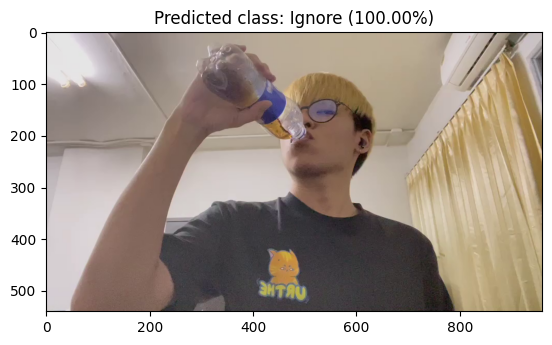



1/1 [==============================] - 0s 40ms/step
Predicted class: Ignore (99.91%)
Prediction:  ['0.00%', '0.03%', '0.01%', '99.91%', '0.03%', '0.02%', '0.00%']


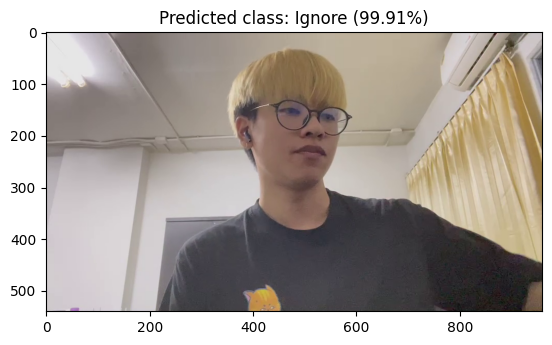



1/1 [==============================] - 0s 35ms/step
Predicted class: Ignore (100.00%)
Prediction:  ['0.00%', '0.00%', '0.00%', '100.00%', '0.00%', '0.00%', '0.00%']


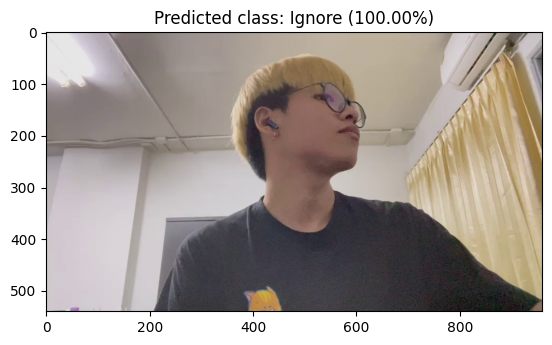



1/1 [==============================] - 0s 34ms/step
Predicted class: Normal (99.35%)
Prediction:  ['0.00%', '0.02%', '0.00%', '0.14%', '99.35%', '0.49%', '0.00%']


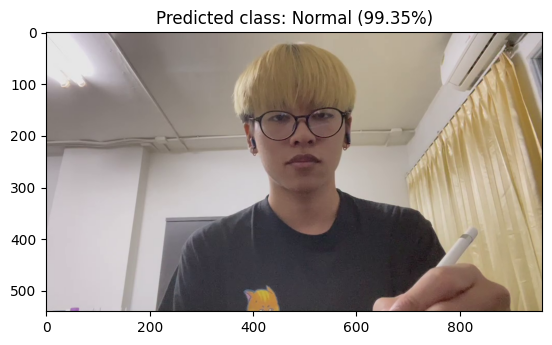



1/1 [==============================] - 0s 36ms/step
Predicted class: Normal (99.91%)
Prediction:  ['0.00%', '0.00%', '0.00%', '0.02%', '99.91%', '0.07%', '0.00%']


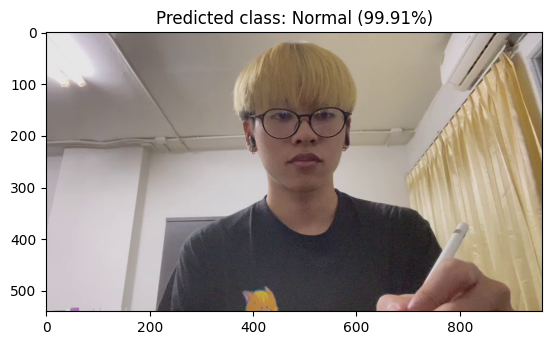



1/1 [==============================] - 0s 36ms/step
Predicted class: Normal (99.94%)
Prediction:  ['0.00%', '0.00%', '0.00%', '0.02%', '99.94%', '0.03%', '0.00%']


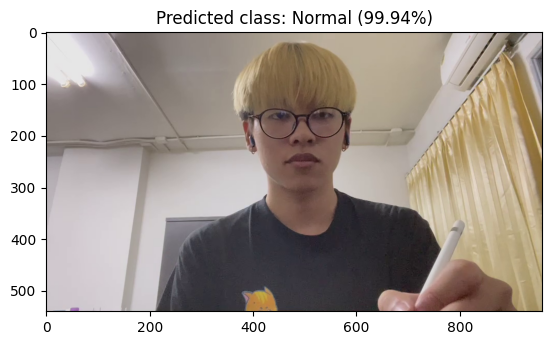



1/1 [==============================] - 0s 49ms/step
Predicted class: Normal (99.90%)
Prediction:  ['0.00%', '0.00%', '0.00%', '0.03%', '99.90%', '0.07%', '0.00%']


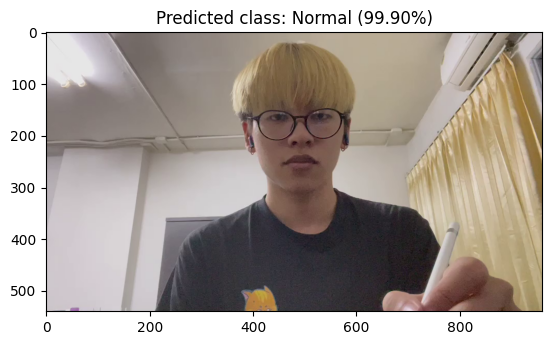



1/1 [==============================] - 0s 39ms/step
Predicted class: Disappear (100.00%)
Prediction:  ['100.00%', '0.00%', '0.00%', '0.00%', '0.00%', '0.00%', '0.00%']


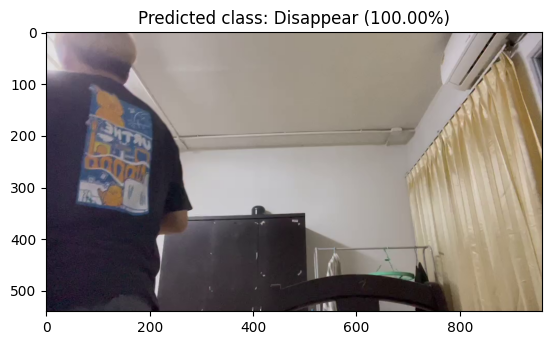



1/1 [==============================] - 0s 40ms/step
Predicted class: Disappear (100.00%)
Prediction:  ['100.00%', '0.00%', '0.00%', '0.00%', '0.00%', '0.00%', '0.00%']


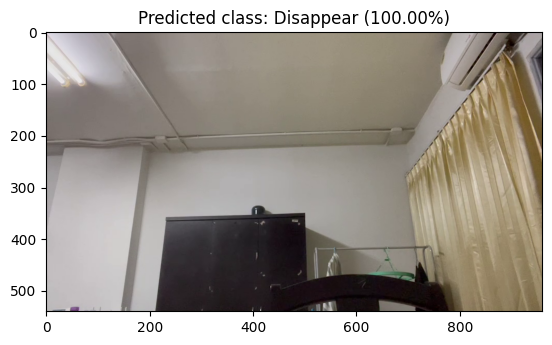



1/1 [==============================] - 0s 33ms/step
Predicted class: Normal (78.44%)
Prediction:  ['0.00%', '0.10%', '0.00%', '21.29%', '78.44%', '0.17%', '0.00%']


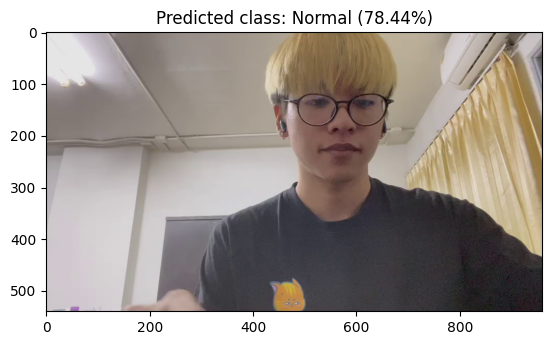



1/1 [==============================] - 0s 35ms/step
Predicted class: Play mobile phone (57.39%)
Prediction:  ['0.00%', '0.15%', '0.00%', '0.69%', '41.76%', '57.39%', '0.00%']


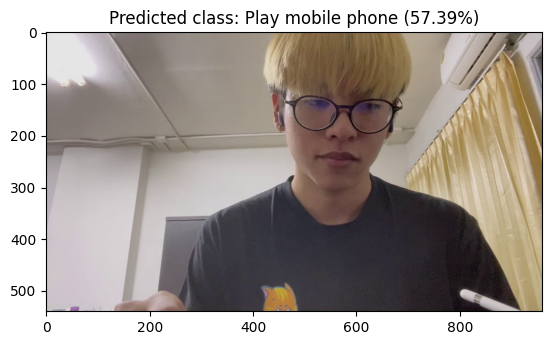



1/1 [==============================] - 0s 38ms/step
Predicted class: Normal (79.30%)
Prediction:  ['0.50%', '0.59%', '1.65%', '10.61%', '79.30%', '3.43%', '3.93%']


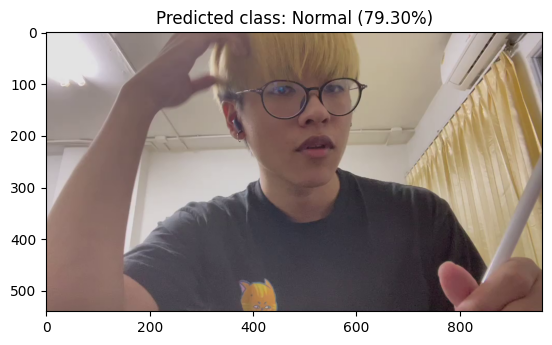



1/1 [==============================] - 0s 25ms/step
Predicted class: Sleep (100.00%)
Prediction:  ['0.00%', '0.00%', '0.00%', '0.00%', '0.00%', '0.00%', '100.00%']


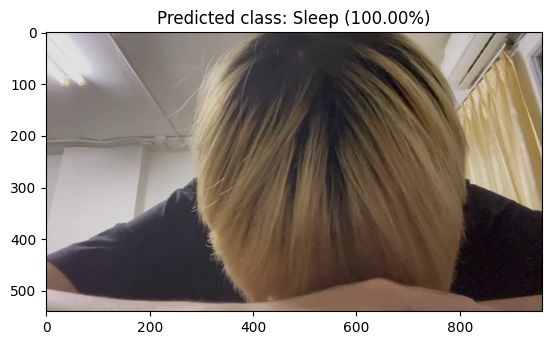

In [ ]:
predicted_attitude = []  # เพิ่มตัวแปร predicted_attitude เพื่อเก็บ predicted_class_name ของแต่ละรูป

# Loop through each image in genpic for analysis
for img in genpic:
    img_array = cv2.resize(img, (224, 224))  # Resize image to target size
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = tf.keras.applications.mobilenet_v3.preprocess_input(img_array)  # Preprocess image

    # Make prediction
    prediction = model.predict(img_array)
    class_names = train_generator.class_indices
    class_names = {v: k for k, v in class_names.items()}  # Reverse the class_indices dictionary
    predicted_class = np.argmax(prediction, axis=1)
    predicted_class_name = class_names[predicted_class[0]]
    predicted_prob = np.max(prediction, axis=1)

    # Append predicted_class_name to predicted_attitude
    predicted_attitude.append(predicted_class_name)

    # Print the result
    print("Predicted class: {} ({:.2f}%)".format(predicted_class_name, predicted_prob[0]*100))
    prediction_list = prediction.tolist()  # Convert the NumPy array to a Python list
    prediction_formatted = ["{:.2%}".format(p) for p in prediction_list[0]]
    print("Prediction: ", prediction_formatted)

    # Display the image with prediction
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for Matplotlib
    plt.title("Predicted class: {} ({:.2f}%)".format(predicted_class_name, predicted_prob[0]*100))
    plt.show()
    print("\n")




In [ ]:
# Print predicted_attitude
print("Predicted attitudes for each image:", predicted_attitude)

Predicted attitudes for each image: ['Sleep', 'Normal', 'Ignore', 'Normal', 'Normal', 'Normal', 'Gape', 'Ignore', 'Ignore', 'Normal', 'Normal', 'Ignore', 'Ignore', 'Ignore', 'Ignore', 'Normal', 'Normal', 'Normal', 'Normal', 'Disappear', 'Disappear', 'Normal', 'Play mobile phone', 'Normal', 'Sleep']


In [ ]:
Disappear = 0
Eating = 0
Gape = 0
Ignore = 0
Normal = 0
Play_mobile_phone = 0
Sleep = 0

# วนลูปผ่านแต่ละคำใน predicted_attitude เพื่อตรวจสอบและเพิ่มค่าในตัวแปรที่เก็บจำนวน
for attitude in predicted_attitude:
    if attitude == 'Disappear':
        Disappear += 1
    elif attitude == 'Eating':
        Eating += 1
    elif attitude == 'Gape':
        Gape += 1
    elif attitude == 'Ignore':
        Ignore += 1
    elif attitude == 'Normal':
        Normal += 1
    elif attitude == 'Play mobile phone':
        Play_mobile_phone += 1
    elif attitude == 'Sleep':
        Sleep += 1

# พิมพ์ค่าของแต่ละตัวแปร
print("Disappear:", Disappear)
print("Eating:", Eating)
print("Gape:", Gape)
print("Ignore:", Ignore)
print("Normal:", Normal)
print("Play_mobile_phone:", Play_mobile_phone)
print("Sleep:", Sleep)


Disappear: 2
Eating: 0
Gape: 1
Ignore: 7
Normal: 12
Play_mobile_phone: 1
Sleep: 2


In [ ]:
persentage_Disappear = round((Disappear / numgenpic) * 100, 2)
persentage_Eating = round((Eating / numgenpic) * 100, 2)
persentage_Gape = round((Gape / numgenpic) * 100, 2)
persentage_Ignore = round((Ignore / numgenpic) * 100, 2)
persentage_Normal = round((Normal / numgenpic) * 100, 2)
persentage_Play_mobile_phone = round((Play_mobile_phone / numgenpic) * 100, 2)
persentage_Sleep = round((Sleep / numgenpic) * 100, 2)

print("Percentage of Disappear: " + str(persentage_Disappear) + "%")
print("Percentage of Eating: " + str(persentage_Eating) + "%")
print("Percentage of Gape: " + str(persentage_Gape) + "%")
print("Percentage of Ignore: " + str(persentage_Ignore) + "%")
print("Percentage of Normal: " + str(persentage_Normal) + "%")
print("Percentage of Play_mobile_phone: " + str(persentage_Play_mobile_phone) + "%")
print("Percentage of Sleep: " + str(persentage_Sleep) + "%")


Percentage of Disappear: 8.0%
Percentage of Eating: 0.0%
Percentage of Gape: 4.0%
Percentage of Ignore: 28.0%
Percentage of Normal: 48.0%
Percentage of Play_mobile_phone: 4.0%
Percentage of Sleep: 8.0%
